In [7]:
import geopandas as gpd

# Read Esri Shapefile
fp = "../data/vector/balades-en-albigeois-actu.shp"
data = gpd.read_file(fp)
display( data.head() )

,NOM,TEMPS,COMMUNE,VARIANTE,DFFICULTE,DENIVELE,LONGUEUR,geometry
0,Lou Saliessol,2H00,SALIES,oui,Facile,208 - 258 M,"6,2 KM","LINESTRING Z (631180.842 6310019.182 0.000, 63..."
1,Chemin de la Gaugne,2H30,FREJAIROLLES,non,Facile,258 - 315 M,10 KM,"LINESTRING Z (638268.028 6309370.088 0.000, 63..."
2,Circuit de Lasbordes,1H40,ALBI,non,Très facile,142 - 169 M,"5,9 KM","LINESTRING Z (630026.818 6315062.165 0.000, 63..."
3,Boucle du Gô,45MIN,ALBI,non,Très facile,155 - 167 M,"2,3 KM","LINESTRING Z (633142.105 6316329.441 0.000, 63..."
4,Chemin des deux Vallons,2H30 à 3H00,CUNAC,non,Moyen,189 - 281 M,"10,6 KM","LINESTRING Z (637597.379 6314630.875 0.000, 63..."


In [2]:
# Read Esri Shapefile
fp = "../data/vector/festivals-global-festivals-_-pl.zip"
dataShpe = gpd.read_file(fp)
display( dataShpe.head() )

# Read CSV format
fp = "../data/vector/festivals-global-festivals-_-pl.csv"
dataCSV = gpd.read_file(fp)
display( dataCSV.head() )

# Read GeoJSON format
fp = "../data/vector/festivals-global-festivals-_-pl.geojson"
dataGeoJSON = gpd.read_file(fp)
display( dataGeoJSON.head() )

DriverError: '/vsizip/../data/vector/festivals-global-festivals-_-pl.zip' does not exist in the file system, and is not recognized as a supported dataset name.

In [8]:
# Write to GeoJSON (just make a copy)
outfp = "../data/vector/Temp/balades-en-albigeois-actu.geojson"
data.to_file(outfp)

DriverError: Failed to create GeoJSON datasource: ../data/vector/Temp/balades-en-albigeois-actu.geojson: ../data/vector/Temp/balades-en-albigeois-actu.geojson: No such file or directory

In [9]:
from shapely.geometry import Polygon
import geopandas as gpd

# Coordinates of the Helsinki Senate square in decimal degrees
coordinates = [
    (24.950899, 60.169158),
    (24.953492, 60.169158),
    (24.953510, 60.170104),
    (24.950958, 60.169990),
]

# Create a Shapely polygon from the coordinate-tuple list
poly = Polygon(coordinates)

In [10]:
# Create the GeoDataFrame with the newly created polygon
newdata = gpd.GeoDataFrame(data=[poly], columns=["geometry"])
display(newdata)

,geometry
0,"POLYGON ((24.95090 60.16916, 24.95349 60.16916..."


In [11]:
# Add a new column and insert data
newdata.at[0, "name"] = "Finnish Senate Square"
display(newdata)

,geometry,name
0,"POLYGON ((24.95090 60.16916, 24.95349 60.16916...",Finnish Senate Square


In [17]:
import pandas as pd
import geopandas as gpd

# Read the desired column in the CSF file and store the data in a DataFrame (Pandas)
city_population = pd.read_csv("../data/vector/global-city-population-estimates.csv",
                               delimiter=";",
                               usecols=["Country or area", "Urban Agglomeration", "Latitude", "Longitude", "Population_2015"], 
                               encoding='latin-1'
                               )
# Print first data
display( city_population.head() )

# Convert longitudes and latitudes to spatial points with WGS84 coordinate system (code "EPSG:4326")
# and add the "geometry" column to the DataFrame
city_population["geometry"] = gpd.points_from_xy(
    x=city_population["Longitude"], y=city_population["Latitude"],
    crs="EPSG:4326"
)

# Generate a GeoDataFrame based on the DataFrame generated 
city_population = gpd.GeoDataFrame(city_population)
display(city_population.head())

,Country or area,Urban Agglomeration,Latitude,Longitude,Population_2015
0,Japan,Tokyo,35.689500,139.691710,38001018
1,India,Delhi,28.666670,77.216670,25703168
2,China,Shanghai,31.220000,121.460000,23740778
3,Brazil,S?o Paulo,-23.550000,-46.640000,21066245
4,India,Mumbai (Bombay),19.073975,72.880838,21042538


,Country or area,Urban Agglomeration,Latitude,Longitude,Population_2015,geometry
0,Japan,Tokyo,35.689500,139.691710,38001018,POINT (139.69171 35.68950)
1,India,Delhi,28.666670,77.216670,25703168,POINT (77.21667 28.66667)
2,China,Shanghai,31.220000,121.460000,23740778,POINT (121.46000 31.22000)
3,Brazil,S?o Paulo,-23.550000,-46.640000,21066245,POINT (-46.64000 -23.55000)
4,India,Mumbai (Bombay),19.073975,72.880838,21042538,POINT (72.88084 19.07398)


In [18]:
import geopandas as gpd
import matplotlib.pyplot as plt

# Read in the data and check the contents
dept = gpd.read_file("../data/vector/departements-20180101-shp.zip")
display( dept.head() )

,code_insee,nom,nuts3,wikipedia,surf_km2,geometry
0,974,La Réunion,FR940,fr:La Réunion,2505.0,"MULTIPOLYGON (((55.21643 -21.03904, 55.21652 -..."
1,11,Aude,FR811,fr:Aude (département),6343.0,"POLYGON ((1.68872 43.27368, 1.69001 43.27423, ..."
2,43,Haute-Loire,FR723,fr:Haute-Loire,5003.0,"POLYGON ((3.08206 45.28988, 3.08209 45.29031, ..."
3,13,Bouches-du-Rhône,FR823,fr:Bouches-du-Rhône,5247.0,"MULTIPOLYGON (((4.23014 43.46047, 4.23025 43.4..."
4,47,Lot-et-Garonne,FR614,fr:Lot-et-Garonne,5385.0,"POLYGON ((-0.14058 44.22648, -0.12931 44.23218..."


In [19]:
# Check contents of the geometry column
display( dept["geometry"].head() )

# Check data type of the geometry column
type( dept["geometry"] )

# Check data type of a value in the geometry column
type( dept["geometry"].values[0] )

0    MULTIPOLYGON (((55.21643 -21.03904, 55.21652 -...
1    POLYGON ((1.68872 43.27368, 1.69001 43.27423, ...
2    POLYGON ((3.08206 45.28988, 3.08209 45.29031, ...
3    MULTIPOLYGON (((4.23014 43.46047, 4.23025 43.4...
4    POLYGON ((-0.14058 44.22648, -0.12931 44.23218...
Name: geometry, dtype: geometry

shapely.geometry.multipolygon.MultiPolygon

<Axes: >

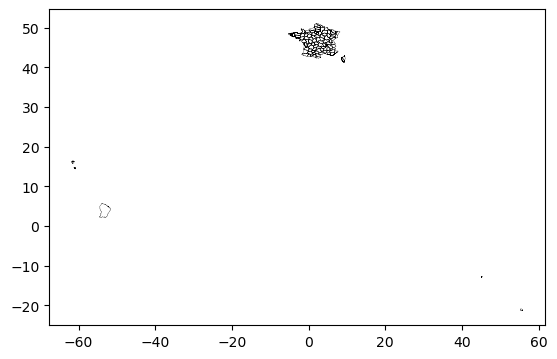

In [20]:
# Display the geometries in a plot
dept.plot(facecolor="none", linewidth=0.2)

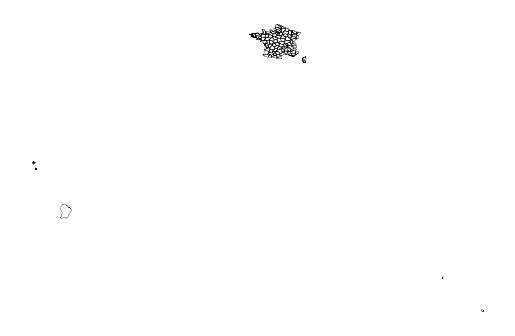

In [21]:
# Display the geometries in a plot
dept.plot(facecolor="none", linewidth=0.2)

# Erase plot axis 
plt.axis("off")
plt.show()

In [22]:
# Display the first city name and geometry
print("Area name:", dept.iloc[3]["nom"], "\t geometry:", dept.iloc[3]["geometry"])

Area name: Bouches-du-Rhône 	 geometry: MULTIPOLYGON (((4.23013639969375 43.46047351660123, 4.230247700957452 43.46121586108104, 4.230189220632457 43.46148938843547, 4.230262972317282 43.46200520745219, 4.230373195602644 43.46268461347228, 4.23031345763625 43.46299301694841, 4.230280848791437 43.46366830422448, 4.230337801980451 43.46490325780324, 4.230436975987817 43.46595406665897, 4.231324691151584 43.47213180394566, 4.231480548853379 43.47308339761441, 4.23172489061066 43.47369729372418, 4.231806547469986 43.47438367395176, 4.231813733992258 43.47505687832774, 4.231746180682893 43.47541019843302, 4.231588256855945 43.4758768124839, 4.23141937358253 43.4762670888901, 4.230630203605431 43.47759121987029, 4.230565524904975 43.47779199139389, 4.230558158719645 43.47822957974404, 4.23045377448363 43.47933386838622, 4.23178534722928 43.48145471606992, 4.23185838026188 43.48157099975371, 4.233760203549888 43.48466468929456, 4.238386886589218 43.49219058903645, 4.23879346408681 43.49289956

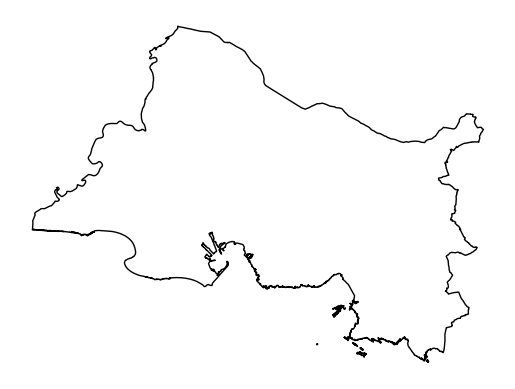

<Figure size 640x480 with 0 Axes>

In [23]:
# Get the geometry of the 4th object
bdr = dept["geometry"].values[3]

# Extract the coordinates of each polygon and add it in the plot
for polygon in bdr.geoms:
    x, y = polygon.exterior.xy
    plt.plot(x, y, color='black', linewidth=1)

# Display the polygon
plt.axis("off")
plt.figure()
plt.show()

In [24]:
centroids = dept["geometry"].centroid 
print(centroids)

0      POINT (55.53251 -21.13316)
1        POINT (2.41362 43.10325)
2        POINT (3.80630 45.12812)
3        POINT (5.08623 43.54305)
4        POINT (0.46075 44.36796)
                  ...            
97      POINT (-2.81232 47.84685)
98       POINT (6.36272 47.16596)
99       POINT (5.69736 46.72937)
100      POINT (4.42558 44.75277)
101      POINT (4.17986 43.99360)
Length: 102, dtype: geometry


/tmp/ipykernel_27450/3266635759.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids = dept["geometry"].centroid


0      POINT (9990996.693 -3050447.365)
1       POINT (3702881.708 2252999.396)
2       POINT (3833574.012 2466493.377)
3       POINT (3923237.014 2283543.026)
4       POINT (3561383.284 2410425.710)
                     ...               
97      POINT (3367074.526 2831128.238)
98      POINT (4045055.339 2679217.404)
99      POINT (3992031.142 2633423.897)
100     POINT (3879156.591 2421007.750)
101     POINT (3853625.065 2338580.794)
Length: 102, dtype: geometry


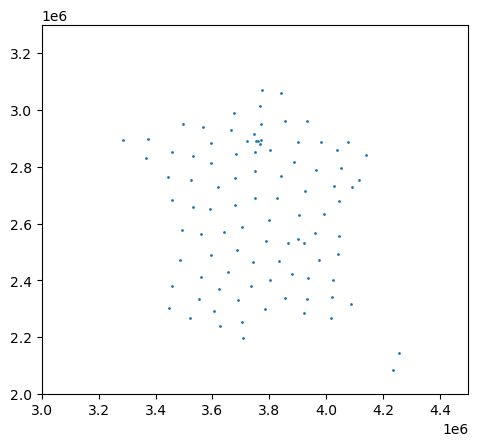

In [25]:
# Project to EPSG3035
dept=dept.to_crs(epsg=3035)

# Process centroids for all polygons
centroids_dept = dept["geometry"].centroid 
print(centroids_dept)

# Display centroids in a specific area
centroids_dept.plot(markersize=1)
plt.xlim(3e6, 4.5e6)  
plt.ylim(2e6, 3.3e6)
plt.show()

MULTIPOLYGON (((9995289.53137758 -3072651.23628527, 9995296.932780698 -3072639.769392474, 9995312.129140673 -3072616.638660753, 9995318.101532139 -3072603.51233709, 9995320.127798468 -3072591.168828811, 9995319.144635931 -3072577.248448579, 9995322.514838936 -3072567.564873327, 9995327.452049255 -3072552.615378194, 9995334.449181803 -3072541.325573034, 9995346.045444239 -3072525.360617427, 9995364.142108226 -3072499.620532535, 9995374.397756886 -3072486.225592875, 9995380.209291033 -3072481.010526193, 9995390.378659427 -3072474.506700782, 9995399.977079064 -3072470.554501717, 9995420.597763725 -3072464.920199371, 9995432.011184581 -3072462.759152145, 9995462.694261938 -3072457.530716002, 9995462.545260578 -3072459.554688826, 9995462.434902465 -3072461.234423512, 9995457.257200189 -3072468.781662919, 9995453.278684625 -3072475.462362954, 9995450.643577375 -3072479.904758939, 9995448.742283951 -3072485.004728141, 9995443.847931737 -3072494.051360264, 9995437.75909378 -3072503.30401763, 9

<Axes: >

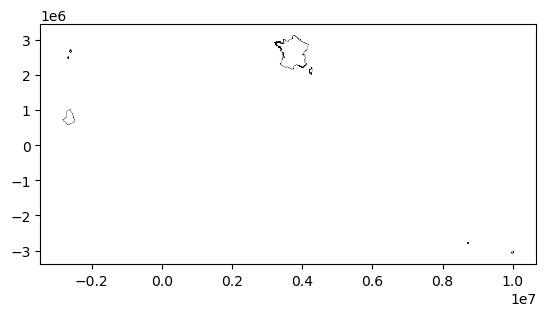

In [26]:
# Process the union of all geometries (a multipolygon in our case)
union_dept = dept["geometry"].unary_union
print(union_dept)

# Decompose the multipolygon as a list of polygons
list_union_dept = list(union_dept.geoms)

# Store this list of polygons in a GeoDataFrame 
union_dept = gpd.GeoDataFrame( geometry = list_union_dept )

# Plot the result
union_dept.plot(facecolor="none", linewidth=0.2)